In [ ]:
import pandas as pd 
data = pd.read_csv("/content/jeridi.csv")
pd.set_option('display.max_rows',None)
data=data.drop(['Unnamed: 0'],axis=1)
data=data.drop(['Unnamed: 0.1'],axis=1)
data

,Description,Duration,Technologies,Topic,Trainees,Location,Field,Company Name
0,development web microservice allow link two ap...,5,our start-up one first tunisian companies depl...,microservice parsing edi,1,sousse,web development,InSoDev
1,project consists designing developing solution...,5,"ia, ml, mysql , python, php, symfony, microser...",delivery optimization service,1,sousse,software development,InSoDev
2,existing service necessary develop service cal...,5,"rest api, nest.js, node.js, mysql, redis.",path calculation service,1,sousse,web development,InSoDev
3,objective stage develop administration allows ...,5,"docker,rest , mysql server , react js",administration web,1,sousse,web development,InSoDev
4,design development solution based automated pr...,5,"testlink , artillery, mochawesome , junit, git...",design development platform automated process,1,sousse,software testing,InSoDev
5,objective internship integrate management tool...,5,"linux debain, web, microservice, data science....",integration data management tool microservice ...,1,sousse,software development,InSoDev
6,scanlog application application intended drive...,5,"testlink , appium, testng,junit ,maven, github...",automation scanlog application tests,1,sousse,software development,InSoDev
7,corner application management traceability cus...,5,"testlink , artillery, mochawesome , junit, git...",performance load test application corner,1,sousse,software development,InSoDev
8,automation build test application deployment c...,5,"terraform , shell , javascript , python enviro...",automation optimization deployment migration a...,1,sousse,cloud computing,InSoDev
9,mission set cicd chain applications coded odoo...,4 to 6,gitlab ci/jenkins - containerd - prometheus - ...,odooflutter cicd,1,sfax,cloud computing,Fogits


In [ ]:
import pandas as pd
import requests
import json
import numpy as np
import pandas as pd
from pandas import json_normalize # easy JSON -> pd.DataFrame

In [ ]:
import spacy
def add_newruler_to_pipeline(skill_pattern_path):
    '''Reads in all created patterns from a JSONL file and adds it to the pipeline after PARSER and before NER'''
    
    #new_ruler = EntityRuler(nlp).from_disk(skill_pattern_path)
    #ruler=nlp.add_pipe('entity_ruler', after='parser')
    ruler=nlp.add_pipe('entity_ruler', after='parser')
    ruler.from_disk(skill_pattern_path)  # loads patterns only
    return ruler
nlp = spacy.load('en_core_web_sm')
nlp.add_pipe = add_newruler_to_pipeline("/content/skill_patterns.jsonl")
#nlp.add_pipe = add_newruler_to_pipeline("/content/skill_db_relax_20.json")

nlp.pipe_names
df1=data

In [ ]:
skillsfinal=[]
for text in df1['Technologies'] :
  new_list=[]
  skills_list = []
  doc=nlp(str(text))
  for ent in doc.ents:
    if ent.label_.startswith("SKILL") or ent.label_=="ORG" :
      skills_list.append(ent.text)
  for value in skills_list:
        if value not in new_list:
            new_list.append(value)
  skillsfinal.append(str(new_list))
df1['Technologies']=skillsfinal

In [ ]:
df1.to_csv("extraction.csv")

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-6-537d08fba5b1>:19: ConvergenceWarning: Number of distinct clusters (79) found smaller than n_clusters (80). Possibly due to duplicate points in X.
  kmeans.fit(tfidf_matrix)
<ipython-input-6-537d08fba5b1>:19: ConvergenceWarning: Number of distinct clusters (79) found smaller than n_clusters (81). Possibly due to duplicate points in X.
  kmeans.fit(tfidf_matrix)
<ipython-input-6-537d08fba5b1>:19: ConvergenceWarning: Number of distinct clusters (79) found smaller than n_clusters (82). Possibly due to duplicate points in X.
  kmeans.fit(tfidf_matrix)
<ipython-input-6-537d08fba5b1>:19: ConvergenceWarning: Number of distinct clusters (79) found smaller than n_clusters (83). Possibly due to duplicate points in X.
  kmeans.fit(tfidf_matrix)
<ipython

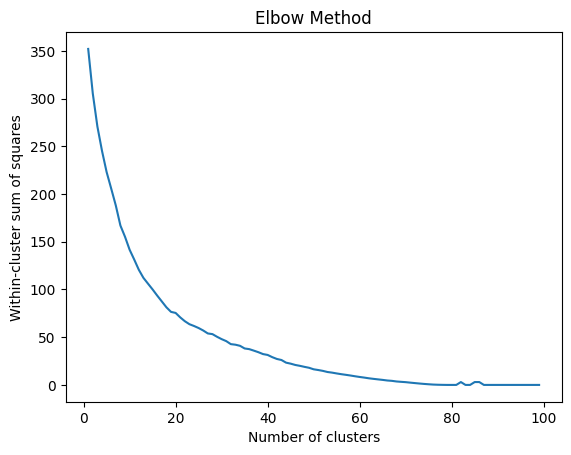

In [ ]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import numpy as np

# Extract the text data
data['Field'] = data['Field'].replace(np.nan, 'software engineer')
text_data = data['Field']

# Create a TF-IDF matrix from the text data
vectorizer = TfidfVectorizer(stop_words='english')
tfidf_matrix = vectorizer.fit_transform(text_data)

# Compute the within-cluster sum of squares for a range of k values
wcss = []
for k in range(1, 100):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(tfidf_matrix)
    wcss.append(kmeans.inertia_)

# Plot the within-cluster sum of squares against k
plt.plot(range(1, 100), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('Within-cluster sum of squares')
plt.show()


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
import pandas as pd


# Extract the technology field column
tech_field = data['Field']

# Convert text data to numerical data using TF-IDF
vectorizer = TfidfVectorizer(stop_words='english')
tech_field_matrix = vectorizer.fit_transform(tech_field)

# Choose the number of clusters
num_clusters = 18

# Apply K-Means clustering algorithm
km = KMeans(n_clusters=num_clusters)
km.fit(tech_field_matrix)

# Add cluster labels to the dataframe
data['Cluster'] = km.labels_

# Print the results
print(data)
data.to_csv("clusters.csv")

                                           Description  \
0    development web microservice allow link two ap...   
1    project consists designing developing solution...   
2    existing service necessary develop service cal...   
3    objective stage develop administration allows ...   
4    design development solution based automated pr...   
5    objective internship integrate management tool...   
6    scanlog application application intended drive...   
7    corner application management traceability cus...   
8    automation build test application deployment c...   
9    mission set cicd chain applications coded odoo...   
10   mission set continuous integration platform mu...   
11   ai chatbot customer request management solutio...   
12   solution enable conversion voice text improve ...   
13   rfid access control app odoo application provi...   
14   business requirement app consists odoo applica...   
15   events app crossplatform solution provides eve...   
16   identity 

In [ ]:
dataC = pd.read_csv("/content/clusters.csv")
pd.set_option('display.max_rows',None)
dataC

,Unnamed: 0,Description,Duration,Technologies,Topic,Trainees,Location,Field,Company Name,Cluster
0,0,development web microservice allow link two ap...,5,"['web', 'microservice', 'parsing', 'web servic...",microservice parsing edi,1,sousse,web development,InSoDev,5
1,1,project consists designing developing solution...,5,"['ia', 'mysql', 'python', 'php', 'symfony']",delivery optimization service,1,sousse,software development,InSoDev,1
2,2,existing service necessary develop service cal...,5,"['rest api', 'nest.js', 'node.js', 'mysql', 'r...",path calculation service,1,sousse,web development,InSoDev,5
3,3,objective stage develop administration allows ...,5,"['docker', 'rest', 'mysql server', 'react js']",administration web,1,sousse,web development,InSoDev,5
4,4,design development solution based automated pr...,5,"['testlink', 'artillery', 'mochawesome', 'juni...",design development platform automated process,1,sousse,software testing,InSoDev,14
5,5,objective internship integrate management tool...,5,"['linux', 'web', 'microservice', 'data science...",integration data management tool microservice ...,1,sousse,software development,InSoDev,1
6,6,scanlog application application intended drive...,5,"['testlink', 'appium', 'junit', 'maven', 'gith...",automation scanlog application tests,1,sousse,software development,InSoDev,1
7,7,corner application management traceability cus...,5,"['testlink', 'artillery', 'mochawesome', 'juni...",performance load test application corner,1,sousse,software development,InSoDev,1
8,8,automation build test application deployment c...,5,"['terraform', 'shell', 'javascript', 'python',...",automation optimization deployment migration a...,1,sousse,cloud computing,InSoDev,4
9,9,mission set cicd chain applications coded odoo...,4 to 6,"['gitlab ci', 'jenkins', 'prometheus', 'kubern...",odooflutter cicd,1,sfax,cloud computing,Fogits,4


In [ ]:
gk = dataC.groupby('Cluster')
gk.get_group(3)

,Unnamed: 0,Description,Duration,Technologies,Topic,Trainees,Location,Field,Company Name,Cluster
69,69,design develop internal order management modul...,4,"['flatter', 'java', 'spring']",development application mobile behalf employe...,1,tunis,business intelligence,Sofrecom,3
94,94,data anonymization study existing data integra...,4,"['java', 'spring', 'big data', 'database', 'ta...",design development multios embeddable mobile ...,1,tunis,business intelligence,Sofrecom,3
95,95,mobile compatible different os allowing ease m...,6,"['android', 'ios', 'flutter', 'dart', 'firebase']",design development web mobile platform implem...,1,tunis,business intelligence,Sofrecom,3
110,110,blockchain creation tool measure blockchain ne...,4,"['blockchain', 'machine learning', 'time series']",development solution exchange wifi connection...,1,tunis,business intelligence,Sofrecom,3
119,119,design blockchain application develop applicat...,6,"['solidity', 'nodejs']",development blockchain solution supervision o...,1,tunis,business intelligence,Sofrecom,3
174,174,within projects treatments tunis team candidat...,6,"['data analysis', 'bi', 'sql', 'reporting', 'f...",construction control dashboard fees,1,tunis,business intelligence,ODDO,3
182,182,need set cognos bi dashboards order 10 provide...,6,"['analytics', 'reporting', 'modelisation', 'sql']",implementation cognos bi dashboards hr department,1,tunis,business intelligence,ODDO,3
201,201,analysis existing solution identification need...,4 to 6,"['power apps', 'sql', 'server', 'c']",design development mobile application managing...,2,tunis,business intelligence,AIVENTU,3
315,315,design andimplementation ofdata modeldesign im...,3,"['sql', 'database design', 'analytics', 'pytho...",collateral management analysis,2,tunis,business intelligence,AxeFinance,3
335,335,design andproductization ofapricing guidelines...,4-6,[],construction real estate rating model,2,tunis,business intelligence,AxeFinance,3


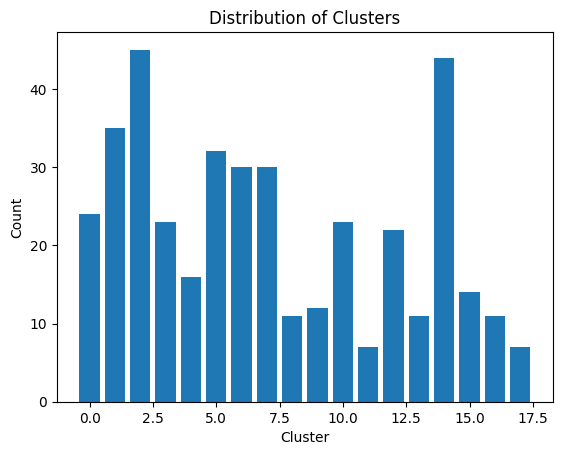

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a bar chart to show the distribution of clusters
cluster_counts = dataC['Cluster'].value_counts()
plt.bar(cluster_counts.index, cluster_counts.values)
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.title('Distribution of Clusters')
plt.show()

In [ ]:
import pandas as pd
import ast

# Group the data by cluster
cluster_groups = dataC.groupby('Cluster')

# Create an empty report dataframe
report_df = pd.DataFrame(columns=['Field', 'Technologies', 'Location', 'Company', 'Duration'])

# Loop over each cluster and extract the required information
for name, group in cluster_groups:
    cluster = name
    technologies_list = group['Technologies'].apply(str).unique()
    my_list = technologies_list
    flat_list = list(set([item for sublist in [ast.literal_eval(x) for x in my_list] for item in sublist]))
    location = group['Location'].apply(str).unique()
    company = group['Company Name'].apply(str).unique()
    duration = group['Duration'].value_counts().idxmax()
  
    
    # Add the information to the report dataframe
    report_df = report_df.append({'Field': dataC[dataC["Cluster"] == cluster]["Field"].iloc[0], 'Technologies': flat_list, 'Location': location, 'Company': company, 'Duration': duration}, ignore_index=True)
report_df.to_csv("clusterTech.csv")
# Print the report
#print(report_df)

<ipython-input-12-31d0b89c5ce0>:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  report_df = report_df.append({'Field': dataC[dataC["Cluster"] == cluster]["Field"].iloc[0], 'Technologies': flat_list, 'Location': location, 'Company': company, 'Duration': duration}, ignore_index=True)
<ipython-input-12-31d0b89c5ce0>:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  report_df = report_df.append({'Field': dataC[dataC["Cluster"] == cluster]["Field"].iloc[0], 'Technologies': flat_list, 'Location': location, 'Company': company, 'Duration': duration}, ignore_index=True)
<ipython-input-12-31d0b89c5ce0>:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  report_df = report_df.append({'Field': dataC[dataC["Cluster"] == cluster]["Field"

In [ ]:
# Create a dictionary mapping cluster numbers to field names
cluster_dict = {cluster: dataC[dataC["Cluster"] == cluster]["Field"].iloc[0] for cluster in dataC["Cluster"].unique()}

# Replace the cluster labels with the field names
dataC["Profile"] = dataC["Cluster"].map(cluster_dict)
dataC

,Unnamed: 0,Description,Duration,Technologies,Topic,Trainees,Location,Field,Company Name,Cluster
0,0,development web microservice allow link two ap...,5,"['web', 'microservice', 'parsing', 'web servic...",microservice parsing edi,1,sousse,web development,InSoDev,5
1,1,project consists designing developing solution...,5,"['ia', 'mysql', 'python', 'php', 'symfony']",delivery optimization service,1,sousse,software development,InSoDev,1
2,2,existing service necessary develop service cal...,5,"['rest api', 'nest.js', 'node.js', 'mysql', 'r...",path calculation service,1,sousse,web development,InSoDev,5
3,3,objective stage develop administration allows ...,5,"['docker', 'rest', 'mysql server', 'react js']",administration web,1,sousse,web development,InSoDev,5
4,4,design development solution based automated pr...,5,"['testlink', 'artillery', 'mochawesome', 'juni...",design development platform automated process,1,sousse,software testing,InSoDev,14
5,5,objective internship integrate management tool...,5,"['linux', 'web', 'microservice', 'data science...",integration data management tool microservice ...,1,sousse,software development,InSoDev,1
6,6,scanlog application application intended drive...,5,"['testlink', 'appium', 'junit', 'maven', 'gith...",automation scanlog application tests,1,sousse,software development,InSoDev,1
7,7,corner application management traceability cus...,5,"['testlink', 'artillery', 'mochawesome', 'juni...",performance load test application corner,1,sousse,software development,InSoDev,1
8,8,automation build test application deployment c...,5,"['terraform', 'shell', 'javascript', 'python',...",automation optimization deployment migration a...,1,sousse,cloud computing,InSoDev,4
9,9,mission set cicd chain applications coded odoo...,4 to 6,"['gitlab ci', 'jenkins', 'prometheus', 'kubern...",odooflutter cicd,1,sfax,cloud computing,Fogits,4


In [ ]:
dataC.to_csv('datawithfieldcluster.csv')

In [ ]:
import pandas as pd 
df = pd.read_csv("/content/FinalData1Clustering.csv")
pd.set_option('display.max_rows',None)
df=df.drop(['Unnamed: 0'],axis=1)
df=df.drop(['Unnamed: 0.1'],axis=1)
df

,companyName,jobTitle,jobLocation,postedAt,jobDescription,workplaceType,jobType,Skills_Description,summaryDescription,CleanTitle,cluster,City,State,Country,title,cluster1
0,Pivotree,Software Engineer- Data Platform,Canada,27/2/2023,role: software engineer - data platform \nintr...,Distance,Fulltime,"commerce, design, ecommerce, business, IP, MDM...",we will help shape the future of frictionless ...,Software Engineer- Data Platform,gl,Canada,Canada,Canada,Software Engineer- Data Platform,13
1,Planet,"Senior Software Engineer, Data Pipeline","Ontario, Canada",3/3/2023,welcome to planet. we believe in using space t...,Distance,Fulltime,"component, design, data processing, PlanetScop...","planet is an equal opportunity employer, and c...","Software Engineer, Data Pipeline",gl,Ontario,Canada,Canada,"Software Engineer, Data Pipeline",13
2,"Blueprint Construction Services, Inc.",Construction & Electrical Staffing Sales Accou...,"Walnut Creek, CA",19/2/2023,looking to add an experienced sales rep / acco...,on-site,Fulltime,"Sales Rep / Account, Construction Trades / Ele...",looking to add an experienced sales rep / acco...,Construction & Electrical Staffing Sales Accou...,business,Walnut Creek,CA,États-Unis,Construction & Electrical Staffing Sales Accou...,4
3,Bristol Myers Squibb,Manager Software Engineer Data Science,"Princeton, NJ",24/02/2023,must work closely with scientists in the data ...,on-site,Fulltime,"data science, python, sql, oracle, unix, shell...",each of us is empowered to apply our individ...,Manager Software Engineer Data Science,gl,Princeton,NJ,États-Unis,Manager Software Engineer Data Science,13
4,Pix4D,Software Engineer C build specialist,"Lausanne, Vaud, Suisse",22/02/2023,"within our growing team, you will play a key r...",Hybrid,Fulltime,"play, security, c, mobile, computer vision, di...",you demonstrate a keen interest in improveme...,Software Engineer C build specialist,gl,Lausanne,Vaud,Suisse,Software Engineer C build specialist,13
5,SEGULA Technologies,Embarked Software Developer,"Toulouse, Occitanie, France",02/07/2023,about the jobcompany descriptionaccelerate you...,Hybrid,Fulltime,"augmented reality, process engineering, comput...",about the jobcompany descriptionaccelerate y...,Embarked Software Developer,gl,Toulouse,Occitanie,France,Embarked Software Developer,16
6,Airbus,Embarked Software Engineer Windriver,"Marseille, Provence-Alpes-Côte dAzur, France",23/02/2023,about the jobjob descriptionand if your advent...,Hybrid,Fulltime,"framework, year.we, innovation.airbus, collabo...",about the jobjob descriptionand if your adve...,Embarked Software Engineer Windriver,gl,Marseille,Provence-Alpes-Côte dAzur,France,Embarked Software Engineer Windriver,13
7,Talenture Group,Android Software Engineer SWE,"Lagos, État de Lagos, Nigéria",22/02/2023,cette offre d’emploi provient d’un site d’offr...,on-site,Fulltime,savoir plusnever,cette offre d’emploi provient d’un site d’of...,Android Software Engineer SWE,gl,Lagos,État de Lagos,Nigéria,Android Software Engineer SWE,13
8,BOARD OFFICE,Partner Sales Manager,"Aalborg, North Jutland, Denmark",19/02/2023,"og derved several leads.at every event, the pa...",on-site,Fulltime,"surveys.candidat, finance, this.i, hubspot, mi...","og derved several leads.at every event, the ...",Partner Sales Manager,business,Aalborg,North Jutland,Denmark,Partner Sales Manager,4
9,Salesforce,Software Engineer II Frontend DevXP,"Birmingham, AL",02/03/2023,the nature of our work is suited to anyone wit...,Remote,Fulltime,"programming language, node.js, javascript, deb...",the nature of our work is suited to anyone w...,Software Engineer II Frontend DevXP,gl,Birmingham,AL,Royaume-Uni,Software Engineer II Frontend DevXP,13


In [ ]:
df["cluster"] = df["cluster"].replace("gl", "software engineering")
df["cluster"] = df["cluster"].replace("BI", "business intelligence")
df["cluster"] = df["cluster"].replace("cloud", "cloud computing")
df["cluster"] = df["cluster"].replace("business", "business management")
df["cluster"] = df["cluster"].replace("Embarked", "embedded development")
df["cluster"] = df["cluster"].replace("DS	", "data science")
df["cluster"] = df["cluster"].replace("civil", "civil engineering")
df["cluster"] = df["cluster"].replace("Mobile", "Mobile development")

In [ ]:
import spacy
def add_newruler_to_pipeline(skill_pattern_path):
    '''Reads in all created patterns from a JSONL file and adds it to the pipeline after PARSER and before NER'''
    
    #new_ruler = EntityRuler(nlp).from_disk(skill_pattern_path)
    #ruler=nlp.add_pipe('entity_ruler', after='parser')
    ruler=nlp.add_pipe('entity_ruler', after='parser')
    ruler.from_disk(skill_pattern_path)  # loads patterns only
    return ruler
nlp = spacy.load('en_core_web_sm')
nlp.add_pipe = add_newruler_to_pipeline("/content/skill_patterns.jsonl")
#nlp.add_pipe = add_newruler_to_pipeline("/content/skill_db_relax_20.json")

nlp.pipe_names
df1=df

In [ ]:
skillsfinal=[]
for text in df1['Skills_Description'] :
  new_list=[]
  skills_list = []
  doc=nlp(str(text))
  for ent in doc.ents:
    if ent.label_.startswith("SKILL") or ent.label_=="ORG" :
      skills_list.append(ent.text)
  for value in skills_list:
        if value not in new_list:
            new_list.append(value)
  skillsfinal.append(str(new_list))
df1['Skills_Description']=skillsfinal

In [ ]:
df1

,companyName,jobTitle,jobLocation,postedAt,jobDescription,workplaceType,jobType,Skills_Description,summaryDescription,CleanTitle,cluster,City,State,Country,title,cluster1
0,Pivotree,Software Engineer- Data Platform,Canada,27/2/2023,role: software engineer - data platform \nintr...,Distance,Fulltime,"['commerce', 'design', 'ecommerce', 'business'...",we will help shape the future of frictionless ...,Software Engineer- Data Platform,software engineering,Canada,Canada,Canada,Software Engineer- Data Platform,13
1,Planet,"Senior Software Engineer, Data Pipeline","Ontario, Canada",3/3/2023,welcome to planet. we believe in using space t...,Distance,Fulltime,"['component', 'design', 'data processing', 'Pl...","planet is an equal opportunity employer, and c...","Software Engineer, Data Pipeline",software engineering,Ontario,Canada,Canada,"Software Engineer, Data Pipeline",13
2,"Blueprint Construction Services, Inc.",Construction & Electrical Staffing Sales Accou...,"Walnut Creek, CA",19/2/2023,looking to add an experienced sales rep / acco...,on-site,Fulltime,"['Construction Trades /', 'Electrical']",looking to add an experienced sales rep / acco...,Construction & Electrical Staffing Sales Accou...,business management,Walnut Creek,CA,États-Unis,Construction & Electrical Staffing Sales Accou...,4
3,Bristol Myers Squibb,Manager Software Engineer Data Science,"Princeton, NJ",24/02/2023,must work closely with scientists in the data ...,on-site,Fulltime,"['data science', 'python', 'sql', 'oracle', 'u...",each of us is empowered to apply our individ...,Manager Software Engineer Data Science,software engineering,Princeton,NJ,États-Unis,Manager Software Engineer Data Science,13
4,Pix4D,Software Engineer C build specialist,"Lausanne, Vaud, Suisse",22/02/2023,"within our growing team, you will play a key r...",Hybrid,Fulltime,"['play', 'security', 'c', 'mobile', 'computer ...",you demonstrate a keen interest in improveme...,Software Engineer C build specialist,software engineering,Lausanne,Vaud,Suisse,Software Engineer C build specialist,13
5,SEGULA Technologies,Embarked Software Developer,"Toulouse, Occitanie, France",02/07/2023,about the jobcompany descriptionaccelerate you...,Hybrid,Fulltime,"['augmented reality', 'process engineering', '...",about the jobcompany descriptionaccelerate y...,Embarked Software Developer,software engineering,Toulouse,Occitanie,France,Embarked Software Developer,16
6,Airbus,Embarked Software Engineer Windriver,"Marseille, Provence-Alpes-Côte dAzur, France",23/02/2023,about the jobjob descriptionand if your advent...,Hybrid,Fulltime,"['framework', 'year.we', 'innovation.airbus', ...",about the jobjob descriptionand if your adve...,Embarked Software Engineer Windriver,software engineering,Marseille,Provence-Alpes-Côte dAzur,France,Embarked Software Engineer Windriver,13
7,Talenture Group,Android Software Engineer SWE,"Lagos, État de Lagos, Nigéria",22/02/2023,cette offre d’emploi provient d’un site d’offr...,on-site,Fulltime,['savoir'],cette offre d’emploi provient d’un site d’of...,Android Software Engineer SWE,software engineering,Lagos,État de Lagos,Nigéria,Android Software Engineer SWE,13
8,BOARD OFFICE,Partner Sales Manager,"Aalborg, North Jutland, Denmark",19/02/2023,"og derved several leads.at every event, the pa...",on-site,Fulltime,"['surveys.candidat', 'finance', 'this.i', 'hub...","og derved several leads.at every event, the ...",Partner Sales Manager,business management,Aalborg,North Jutland,Denmark,Partner Sales Manager,4
9,Salesforce,Software Engineer II Frontend DevXP,"Birmingham, AL",02/03/2023,the nature of our work is suited to anyone wit...,Remote,Fulltime,"['programming language', 'node.js', 'javascrip...",the nature of our work is suited to anyone w...,Software Engineer II Frontend DevXP,software engineering,Birmingham,AL,Royaume-Uni,Software Engineer II Frontend DevXP,13


In [ ]:
df1.to_csv("jobs1.csv")

In [ ]:
df1 = df1.drop('jobTitle', axis=1)
df1 = df1.drop('postedAt', axis=1) 
df1 = df1.drop('jobDescription', axis=1)
df1 = df1.drop('workplaceType', axis=1) 
df1 = df1.drop('jobType', axis=1) 
df1 = df1.drop('CleanTitle', axis=1)
df1 = df1.drop('State', axis=1)
df1 = df1.drop('jobLocation', axis=1)
df1 = df1.drop('title', axis=1)
df1 = df1.drop('cluster1', axis=1)

In [ ]:
df1.rename(columns={'companyName': 'Company Name'}, inplace=True)
df1.rename(columns={'cluster': 'Field'}, inplace=True)
df1.rename(columns={'Country': 'Location'}, inplace=True)
df1.rename(columns={'Skills_Description': 'Technologies'}, inplace=True)
df1.rename(columns={'summaryDescription': 'Description'}, inplace=True)
df1.rename(columns={'City': 'City'}, inplace=True)

In [ ]:
df1.to_csv("jobs3.csv")

In [ ]:
df1

,Company Name,Technologies,Description,Field,City,Location
0,Pivotree,"['commerce', 'design', 'ecommerce', 'business'...",we will help shape the future of frictionless ...,software engineering,Canada,Canada
1,Planet,"['component', 'design', 'data processing', 'Pl...","planet is an equal opportunity employer, and c...",software engineering,Ontario,Canada
2,"Blueprint Construction Services, Inc.","['Construction Trades /', 'Electrical']",looking to add an experienced sales rep / acco...,business management,Walnut Creek,États-Unis
3,Bristol Myers Squibb,"['data science', 'python', 'sql', 'oracle', 'u...",each of us is empowered to apply our individ...,software engineering,Princeton,États-Unis
4,Pix4D,"['play', 'security', 'c', 'mobile', 'computer ...",you demonstrate a keen interest in improveme...,software engineering,Lausanne,Suisse
5,SEGULA Technologies,"['augmented reality', 'process engineering', '...",about the jobcompany descriptionaccelerate y...,software engineering,Toulouse,France
6,Airbus,"['framework', 'year.we', 'innovation.airbus', ...",about the jobjob descriptionand if your adve...,software engineering,Marseille,France
7,Talenture Group,['savoir'],cette offre d’emploi provient d’un site d’of...,software engineering,Lagos,Nigéria
8,BOARD OFFICE,"['surveys.candidat', 'finance', 'this.i', 'hub...","og derved several leads.at every event, the ...",business management,Aalborg,Denmark
9,Salesforce,"['programming language', 'node.js', 'javascrip...",the nature of our work is suited to anyone w...,software engineering,Birmingham,Royaume-Uni


In [ ]:
df1['Location'] = df1['Location'].str.upper()
df1['Location'] = df1['Location'].str.lower().str.replace("é", "e").str.upper()
df1['Location'] = df1['Location'].str.replace("Ê", "E")
df1['Location'] = df1['Location'].str.replace("È", "E")
df1['Location'] = df1['Location'].str.replace("Ü", "U")
df1['Location'] = df1['Location'].str.replace("Ã", "A")
df1['Location'] = df1['Location'].str.replace("Î", "I")
df1['Location'] = df1['Location'].str.replace("Â", "A")
df1['Location'] = df1['Location'].str.replace("Ô", "O")
df1['Location'] = df1['Location'].str.replace("Ø", "O")
df1['City'] = df1['City'].str.upper()
df1['City'] = df1['City'].str.lower().str.replace("é", "e").str.upper()
df1['City'] = df1['City'].str.replace("Ê", "E")
df1['City'] = df1['City'].str.replace("È", "E")
df1['City'] = df1['City'].str.replace("Ü", "U")
df1['City'] = df1['City'].str.replace("Ã", "A")
df1['City'] = df1['City'].str.replace("Î", "I")
df1['City'] = df1['City'].str.replace("Â", "A")
df1['City'] = df1['City'].str.replace("Ô", "O")
df1['City'] = df1['City'].str.replace("Ø", "O")

In [ ]:
df1

,Company Name,Technologies,Description,Field,City,Location
0,Pivotree,"['commerce', 'design', 'ecommerce', 'business'...",we will help shape the future of frictionless ...,software engineering,CANADA,CANADA
1,Planet,"['component', 'design', 'data processing', 'Pl...","planet is an equal opportunity employer, and c...",software engineering,ONTARIO,CANADA
2,"Blueprint Construction Services, Inc.","['Construction Trades /', 'Electrical']",looking to add an experienced sales rep / acco...,business management,WALNUT CREEK,ETATS-UNIS
3,Bristol Myers Squibb,"['data science', 'python', 'sql', 'oracle', 'u...",each of us is empowered to apply our individ...,software engineering,PRINCETON,ETATS-UNIS
4,Pix4D,"['play', 'security', 'c', 'mobile', 'computer ...",you demonstrate a keen interest in improveme...,software engineering,LAUSANNE,SUISSE
5,SEGULA Technologies,"['augmented reality', 'process engineering', '...",about the jobcompany descriptionaccelerate y...,software engineering,TOULOUSE,FRANCE
6,Airbus,"['framework', 'year.we', 'innovation.airbus', ...",about the jobjob descriptionand if your adve...,software engineering,MARSEILLE,FRANCE
7,Talenture Group,['savoir'],cette offre d’emploi provient d’un site d’of...,software engineering,LAGOS,NIGERIA
8,BOARD OFFICE,"['surveys.candidat', 'finance', 'this.i', 'hub...","og derved several leads.at every event, the ...",business management,AALBORG,DENMARK
9,Salesforce,"['programming language', 'node.js', 'javascrip...",the nature of our work is suited to anyone w...,software engineering,BIRMINGHAM,ROYAUME-UNI


In [ ]:
data = pd.read_csv("/content/datawithfieldcluster.csv")
pd.set_option('display.max_rows',None)
data=data.drop(['Unnamed: 0'],axis=1)
data

,Unnamed: 0.1,Description,Duration,Technologies,Topic,Trainees,Location,Field,Company Name,Cluster
0,0,development web microservice allow link two ap...,5,"['web', 'microservice', 'parsing', 'web servic...",microservice parsing edi,1,sousse,web development,InSoDev,5
1,1,project consists designing developing solution...,5,"['ia', 'mysql', 'python', 'php', 'symfony']",delivery optimization service,1,sousse,software development,InSoDev,1
2,2,existing service necessary develop service cal...,5,"['rest api', 'nest.js', 'node.js', 'mysql', 'r...",path calculation service,1,sousse,web development,InSoDev,5
3,3,objective stage develop administration allows ...,5,"['docker', 'rest', 'mysql server', 'react js']",administration web,1,sousse,web development,InSoDev,5
4,4,design development solution based automated pr...,5,"['testlink', 'artillery', 'mochawesome', 'juni...",design development platform automated process,1,sousse,software testing,InSoDev,14
5,5,objective internship integrate management tool...,5,"['linux', 'web', 'microservice', 'data science...",integration data management tool microservice ...,1,sousse,software development,InSoDev,1
6,6,scanlog application application intended drive...,5,"['testlink', 'appium', 'junit', 'maven', 'gith...",automation scanlog application tests,1,sousse,software development,InSoDev,1
7,7,corner application management traceability cus...,5,"['testlink', 'artillery', 'mochawesome', 'juni...",performance load test application corner,1,sousse,software development,InSoDev,1
8,8,automation build test application deployment c...,5,"['terraform', 'shell', 'javascript', 'python',...",automation optimization deployment migration a...,1,sousse,cloud computing,InSoDev,4
9,9,mission set cicd chain applications coded odoo...,4 to 6,"['gitlab ci', 'jenkins', 'prometheus', 'kubern...",odooflutter cicd,1,sfax,cloud computing,Fogits,4


In [ ]:
data = data.drop('Unnamed: 0.1', axis=1)
data = data.drop('Cluster', axis=1)


In [ ]:
data

,Description,Technologies,Location,Field,Company Name
0,development web microservice allow link two ap...,"['web', 'microservice', 'parsing', 'web servic...",sousse,web development,InSoDev
1,project consists designing developing solution...,"['ia', 'mysql', 'python', 'php', 'symfony']",sousse,software development,InSoDev
2,existing service necessary develop service cal...,"['rest api', 'nest.js', 'node.js', 'mysql', 'r...",sousse,web development,InSoDev
3,objective stage develop administration allows ...,"['docker', 'rest', 'mysql server', 'react js']",sousse,web development,InSoDev
4,design development solution based automated pr...,"['testlink', 'artillery', 'mochawesome', 'juni...",sousse,software testing,InSoDev
5,objective internship integrate management tool...,"['linux', 'web', 'microservice', 'data science...",sousse,software development,InSoDev
6,scanlog application application intended drive...,"['testlink', 'appium', 'junit', 'maven', 'gith...",sousse,software development,InSoDev
7,corner application management traceability cus...,"['testlink', 'artillery', 'mochawesome', 'juni...",sousse,software development,InSoDev
8,automation build test application deployment c...,"['terraform', 'shell', 'javascript', 'python',...",sousse,cloud computing,InSoDev
9,mission set cicd chain applications coded odoo...,"['gitlab ci', 'jenkins', 'prometheus', 'kubern...",sfax,cloud computing,Fogits


In [ ]:
data.to_csv("pfeoffers1.csv")

In [ ]:
import pandas as pd

# Read the PFE offers CSV file and add a 'Type' column with value 'PFE'
pfe_offers = pd.read_csv('/content/pfeoffers1.csv')
pfe_offers['Type'] = 'PFE'
pfe_offers.rename(columns={'Location': 'City'}, inplace=True)
pfe_offers['Location'] = 'TUNISIE'
# Read the Job offers CSV file and add a 'Type' column with value 'Job'
job_offers = pd.read_csv('/content/jobs3.csv')
job_offers['Type'] = 'Job'

# Concatenate the two DataFrames vertically
merged_df = pd.concat([pfe_offers, job_offers], ignore_index=True)


merged_df

,Unnamed: 0,Description,Technologies,City,Field,Company Name,Type,Location
0,0,development web microservice allow link two ap...,"['web', 'microservice', 'parsing', 'web servic...",sousse,web development,InSoDev,PFE,TUNISIE
1,1,project consists designing developing solution...,"['ia', 'mysql', 'python', 'php', 'symfony']",sousse,software development,InSoDev,PFE,TUNISIE
2,2,existing service necessary develop service cal...,"['rest api', 'nest.js', 'node.js', 'mysql', 'r...",sousse,web development,InSoDev,PFE,TUNISIE
3,3,objective stage develop administration allows ...,"['docker', 'rest', 'mysql server', 'react js']",sousse,web development,InSoDev,PFE,TUNISIE
4,4,design development solution based automated pr...,"['testlink', 'artillery', 'mochawesome', 'juni...",sousse,software testing,InSoDev,PFE,TUNISIE
5,5,objective internship integrate management tool...,"['linux', 'web', 'microservice', 'data science...",sousse,software development,InSoDev,PFE,TUNISIE
6,6,scanlog application application intended drive...,"['testlink', 'appium', 'junit', 'maven', 'gith...",sousse,software development,InSoDev,PFE,TUNISIE
7,7,corner application management traceability cus...,"['testlink', 'artillery', 'mochawesome', 'juni...",sousse,software development,InSoDev,PFE,TUNISIE
8,8,automation build test application deployment c...,"['terraform', 'shell', 'javascript', 'python',...",sousse,cloud computing,InSoDev,PFE,TUNISIE
9,9,mission set cicd chain applications coded odoo...,"['gitlab ci', 'jenkins', 'prometheus', 'kubern...",sfax,cloud computing,Fogits,PFE,TUNISIE


In [ ]:
merged_df["Field"] = merged_df["Field"].replace("Dev", "software development")
merged_df["Field"] = merged_df["Field"].replace("DS", "data science")
merged_df["Field"] = merged_df["Field"].replace("electronic engineering", "electronic , mechanical engineering")

In [ ]:
merged_df

,Unnamed: 0,Description,Technologies,City,Field,Company Name,Type,Location
0,0,development web microservice allow link two ap...,"['web', 'microservice', 'parsing', 'web servic...",sousse,web development,InSoDev,PFE,TUNISIE
1,1,project consists designing developing solution...,"['ia', 'mysql', 'python', 'php', 'symfony']",sousse,software development,InSoDev,PFE,TUNISIE
2,2,existing service necessary develop service cal...,"['rest api', 'nest.js', 'node.js', 'mysql', 'r...",sousse,web development,InSoDev,PFE,TUNISIE
3,3,objective stage develop administration allows ...,"['docker', 'rest', 'mysql server', 'react js']",sousse,web development,InSoDev,PFE,TUNISIE
4,4,design development solution based automated pr...,"['testlink', 'artillery', 'mochawesome', 'juni...",sousse,software testing,InSoDev,PFE,TUNISIE
5,5,objective internship integrate management tool...,"['linux', 'web', 'microservice', 'data science...",sousse,software development,InSoDev,PFE,TUNISIE
6,6,scanlog application application intended drive...,"['testlink', 'appium', 'junit', 'maven', 'gith...",sousse,software development,InSoDev,PFE,TUNISIE
7,7,corner application management traceability cus...,"['testlink', 'artillery', 'mochawesome', 'juni...",sousse,software development,InSoDev,PFE,TUNISIE
8,8,automation build test application deployment c...,"['terraform', 'shell', 'javascript', 'python',...",sousse,cloud computing,InSoDev,PFE,TUNISIE
9,9,mission set cicd chain applications coded odoo...,"['gitlab ci', 'jenkins', 'prometheus', 'kubern...",sfax,cloud computing,Fogits,PFE,TUNISIE


In [ ]:
merged_df = merged_df.drop('Unnamed: 0', axis=1)
merged_df = merged_df.drop('Description', axis=1)

In [ ]:
merged_df

,Technologies,City,Field,Company Name,Type,Location
0,"['web', 'microservice', 'parsing', 'web servic...",sousse,web development,InSoDev,PFE,TUNISIE
1,"['ia', 'mysql', 'python', 'php', 'symfony']",sousse,software development,InSoDev,PFE,TUNISIE
2,"['rest api', 'nest.js', 'node.js', 'mysql', 'r...",sousse,web development,InSoDev,PFE,TUNISIE
3,"['docker', 'rest', 'mysql server', 'react js']",sousse,web development,InSoDev,PFE,TUNISIE
4,"['testlink', 'artillery', 'mochawesome', 'juni...",sousse,software testing,InSoDev,PFE,TUNISIE
5,"['linux', 'web', 'microservice', 'data science...",sousse,software development,InSoDev,PFE,TUNISIE
6,"['testlink', 'appium', 'junit', 'maven', 'gith...",sousse,software development,InSoDev,PFE,TUNISIE
7,"['testlink', 'artillery', 'mochawesome', 'juni...",sousse,software development,InSoDev,PFE,TUNISIE
8,"['terraform', 'shell', 'javascript', 'python',...",sousse,cloud computing,InSoDev,PFE,TUNISIE
9,"['gitlab ci', 'jenkins', 'prometheus', 'kubern...",sfax,cloud computing,Fogits,PFE,TUNISIE


In [ ]:
merged_df.to_csv('offersmerged.csv', index=False)